# TS Use Case

In this notebook we will give an example of how publicly available panel data can be downloaded and passed through the causaLens platform to obtain highly accurate out-of-sample predictions.

### Dependencies

This tutorial will require the user to install the following packages:
* pandas
* alphalens

The following files will also be needed locally:
* MKtData.py

In [2]:
import MktData
import pandas as pd
import numpy as np
import pprint
import cl_api
import alphalens
from cl_api.base_definitions import Definitions, ExperimentPeriod, TrainingMode, AlgosGroups
from bokeh.plotting import figure, output_file, show
import matplotlib.pyplot as plt
from clpu import CLPULab
from cl_api.config.feature_config import FeatureConstraints
from cl_api.discoverer_params import BaselineDiscovererParams
from importlib import reload 
import strategies
reload(strategies)
BackTestStrat = strategies.BackTestStrat
from pypfopt import EfficientFrontier

/Users/tadhgokeeffe/env/lib/python3.8/site-packages/pandas_datareader/compat/__init__.py:7: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  from pandas.util.testing import assert_frame_equal


### Downloading daily ticker data

With our packages imported with can now specify a list of tickers we are interested in and download the historical EOD data.

In [3]:
# define universe of instruments

tickers = ['V', 'JPM', 'MA', 'BAC', 'C', 'WFC', 'BLK', 'SPGI', 'AXP', 'GS',
       'MS', 'CME', 'ICE', 'TFC', 'USB', 'PNC', 'MCO', 'SCHW', 'BX',
       'TROW', 'MSCI', 'BK', 'COF', 'STT', 'FRC', 'AMP', 'MKTX', 'NTRS',
       'DFS', 'NDAQ', 'FITB', 'MTB', 'FDS', 'SYF', 'SIVB', 'KEY', 'ETFC',
       'CFG', 'RF', 'FNF', 'HBAN', 'AMTD', 'RJF', 'ALLY', 'LPLA', 'CACC',
       'SEIC', 'BEN', 'CBSH', 'SBNY', 'CMA', 'ZION', 'FHN', 'PB', 'EWBC',
       'PBCT', 'NYCB', 'FFIN', 'EV', 'TCF', 'CFR', 'TW', 'IVZ', 'ESNT',
       'IBKR', 'UBSI', 'SF', 'LAZ', 'WAL', 'AMG', 'FCNCA', 'MORN', 'BPOP',
       'GBCI', 'JHG', 'SNV', 'VLY', 'OZK', 'RDN', 'PNFP', 'MTG', 'HOMB',
       'SLM', 'TREE', 'WTFC', 'FNB', 'GDOT', 'WBS', 'FHI', 'EVR', 'FCFS',
       'UMPQ', 'STL', 'BOH', 'FHB', 'PACW', 'UMBF', 'BXS', 'OMF', 'ASB',
       'BKU', 'CATY', 'CIT', 'BOKF', 'WAFD', 'SC', 'IBOC', 'TCBI', 'HWC',
       'VIRT', 'ISBC', 'FULT', 'TRMK', 'NAVI', 'CFFN', 'TFSL']

portfolio = MktData.Portfolio()

for elm in tickers:
    portfolio.Add_Asset( elm, "US", 1, 'USD')

In [4]:
# download instruments
df = portfolio.Factors_df()

V successful.
JPM successful.
MA successful.
BAC successful.
C successful.
WFC successful.
BLK successful.
SPGI successful.
AXP successful.
GS successful.
MS successful.
CME successful.
ICE successful.
TFC successful.
USB successful.
PNC successful.
MCO successful.
SCHW successful.
BX successful.
TROW successful.
MSCI successful.
BK successful.
COF successful.
STT successful.
FRC successful.
AMP successful.
MKTX successful.
NTRS successful.
DFS successful.
NDAQ successful.
FITB successful.
MTB successful.
FDS successful.
SYF successful.
SIVB successful.
KEY successful.
ETFC successful.
CFG successful.
RF successful.
FNF successful.
HBAN successful.
AMTD successful.
RJF successful.
ALLY successful.
LPLA successful.


/Users/tadhgokeeffe/env/lib/python3.8/site-packages/pandas/core/series.py:679: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


CACC successful.
SEIC successful.
BEN successful.
CBSH successful.
SBNY successful.
CMA successful.
ZION successful.
FHN successful.
PB successful.
EWBC successful.
PBCT successful.
NYCB successful.
FFIN successful.
EV successful.
TCF successful.
CFR successful.
TW successful.
IVZ successful.
ESNT successful.
IBKR successful.
UBSI successful.
SF successful.
LAZ successful.
WAL successful.
AMG successful.
FCNCA successful.
MORN successful.
BPOP successful.
GBCI successful.
JHG successful.
SNV successful.
VLY successful.
OZK successful.
RDN successful.
PNFP successful.
MTG successful.
HOMB successful.
SLM successful.
TREE successful.
WTFC successful.
FNB successful.
GDOT successful.
WBS successful.
FHI successful.
EVR successful.
FCFS successful.
UMPQ successful.
STL successful.
BOH successful.
FHB successful.
PACW successful.
UMBF successful.
BXS successful.
OMF successful.
ASB successful.
BKU successful.
CATY successful.
CIT successful.
BOKF successful.
WAFD successful.
SC successful.


In [5]:
# we can save the dataframe to a csv so that next time we don't need to redownload the data
df.to_csv('./ticker_data.csv')

## Data Inspection and Processing

With the data downloaded we can now start with looking at our data to see what we are working with and then carrying out some basic data-processing.

In [6]:
# printing head of dataframe
df.head()

,Assets to Equity,EBIT to Equity,Liability to Assets,Liability to Equity,Short Term Debt to Cash,Earnings per Share,Assets Yield,Investments Yield,Profit Margin,Book Price,...,1y ma,1m ma,1y1m momentum,CountryName,Sector,Industry,GicSector,GicIndustry,GicSubIndustry,Ticker
2000-02-04,22.858615,0.0,0.956253,21.858615,NaN,NaN,0.003784,NaN,0.0,NaN,...,NaN,NaN,NaN,USA,Financial Services,Capital Markets,Financials,Capital Markets,Investment Banking & Brokerage,MS
2000-02-04,24.954398,0.0,0.959927,23.954398,NaN,NaN,0.003203,NaN,0.0,NaN,...,NaN,NaN,NaN,USA,Financial Services,Capital Markets,Financials,Capital Markets,Investment Banking & Brokerage,GS
2000-03-06,7.521149,NaN,0.867042,6.521149,NaN,NaN,0.002505,NaN,NaN,NaN,...,NaN,NaN,NaN,USA,Financial Services,Banks—Regional,Financials,Thrifts & Mortgage Finance,Thrifts & Mortgage Finance,CFFN
2000-03-06,1.756528,0.0,0.430695,0.756528,NaN,NaN,0.074495,NaN,0.0,NaN,...,NaN,NaN,NaN,USA,Financial Services,Asset Management,Financials,Capital Markets,Asset Management & Custody Banks,EV
2000-04-04,1.244915,NaN,0.196732,0.244915,NaN,NaN,0.064426,NaN,NaN,NaN,...,NaN,NaN,NaN,USA,Financial Services,Financial Data & Stock Exchanges,Financials,Capital Markets,Financial Exchanges & Data,FDS


In [7]:
# printing list of columns in dataframe
pp = pprint.PrettyPrinter()
pp.pprint(list(df.columns))

['Assets to Equity',
 'EBIT to Equity',
 'Liability to Assets',
 'Liability to Equity',
 'Short Term Debt to Cash',
 'Earnings per Share',
 'Assets Yield',
 'Investments Yield',
 'Profit Margin',
 'Book Price',
 'Short Term Debt Ratio',
 'Income Ratio',
 'Asset Ratio',
 'Stock Sale/Purchase Ratio',
 'Div Yield',
 'EBIT ratio',
 'Equity Ratio',
 'Cash Ratio',
 'Borrowing Ratio',
 'shares',
 'Adjusted_close',
 'marketCap',
 '1y vol',
 '1m vol',
 '1y ma',
 '1m ma',
 '1y1m momentum',
 'CountryName',
 'Sector',
 'Industry',
 'GicSector',
 'GicIndustry',
 'GicSubIndustry',
 'Ticker']


In [8]:
# simple plot of price data for two instruments

tmp = df[df['Ticker'].isin(['NYCB'])]
x1 = tmp.index.unique()
y1 = tmp['Adjusted_close'].values

tmp = df[df['Ticker'].isin(['V'])]
x2 = tmp.index.unique()
y2 = tmp['Adjusted_close'].values

p = figure(plot_width=400, plot_height=400)

# add a line renderer
p.line(x1, y1, line_width=2, legend_label="NYCB", line_color='green')
p.line(x2, y2, line_width=2, legend_label="V", line_color='red')

show(p)

The first piece of processing we want to do is to drop the individuals for which we only have recent data.

In [9]:
x = set(df[df.index<'2005-01-01']['Ticker'].unique())

num_individuals = len(x)

df = df[df['Ticker'].isin(list(x))]
df = df[df.index>'2015-01-01']

* Next we can drop the sector information since these columns only have one unique categorical value and as such will not be useful for modelling.

* We also need to rename the columns which defines our individuals as '__panel'.

* This is the column name which the causaLens platform recognises for panel datasets.

In [10]:
df = df.drop(columns=['CountryName', 'Sector', 'GicSector'])
df = df.rename(columns={'Ticker': '__panel'})

## Convert from DataFrame to causaLens format Dataset

The causaLens platform uses our own specialised data format. A pandas dataframe can easily be converted in to this format provided the index is sorted to be monotonically increasing.

In [11]:
# we first convert our dataframe in to a causaLens dataset
dataset = cl_api.AlignedDataset.from_dataframe(df)

Next we want to modify our data to be weekly resolution instead of daily. We could perform this realignment manually, but it is extremely easy to do using the platform.

In [12]:
# we first create a causaLens api so that we don't need to perform the operations locally
api = cl_api.CausalensApi('https://voyager.causalens.com', 'c39cb99b-a47f-42e5-a464-bc133cb893c4')

# we also create a CLPULab which is where we will run our experiments.
clpu_lab = CLPULab()

INFO:cl_api.apis.remote_api:Instantiated causaLens API version 1.7.12


In [13]:
# we use a config object to give the CLPULab all the details of what we want to do
config = cl_api.Config()
config.targets = [cl_api.TargetSpec(target_column='Adjusted_close', time_delta=0)]
config.data_config.alignment_config.desired_resolution = {'type': 'weekly'}

config.api = api

In [14]:
# now we can get the CLPULab to modify our data to weekly resolution
prepared_dataset = clpu_lab.modify_data(data=dataset, config=config)
from cl_api.library.modelling.panel_normalizer import PanelNormalizer
normalizer = PanelNormalizer()
prepared_dataset = normalizer.fit_normalize(prepared_dataset)

INFO:clpu.modelling.preparation.data_preparation:  ----- 
INFO:clpu.modelling.preparation.data_preparation:  Aligning dataset of 31 column(s) and 1 target(s).
INFO:clpu.modelling.preparation.data_preparation:  Aligning to {'desired_resolution': {'type': 'weekly'}}.
INFO:clpu.modelling.preparation.data_preparation:  Searching for known in advance columns, columns will be forwarded by 0 points forward.
INFO:clpu.modelling.preparation.data_preparation:  Dataset is aligned: rows=28608, resolution={'type': 'weekly', 'dow': 5, 'hour': 23, 'minute': 59, 'sec': 59}.
INFO:clpu.modelling.preparation.data_preparation:  Final dataset: rows=28608, resolution={'type': 'weekly', 'dow': 5, 'hour': 23, 'minute': 59, 'sec': 59}.
INFO:clpu.modelling.preparation.data_preparation:  ----- 


/Users/tadhgokeeffe/env/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1540: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')
/Users/tadhgokeeffe/env/lib/python3.8/site-packages/cl_api/library/modelling/panel_normalizer.py:46: RuntimeWarning: Mean of empty slice
  mean = numpy.nanmean(np_values)
/Users/tadhgokeeffe/env/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


INFO:cl_api.library.modelling.panel_normalizer:Column Assets to Equity has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column EBIT to Equity has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Liability to Assets has positive values.
INFO:cl_api.library.modelling.panel_normalizer:Column Liability to Equity has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Short Term Debt to Cash has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Earnings per Share has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Assets Yield has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Investments Yield has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Profit Margin has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Book Price has negative values.
INFO:cl_api.library.modelling.panel_normalizer:Column Short Term Debt Ratio has

/Users/tadhgokeeffe/env/lib/python3.8/site-packages/cl_api/library/modelling/panel_normalizer.py:110: RuntimeWarning: invalid value encountered in subtract
  np_values[indices] -= mean


In [15]:
df_eow = prepared_dataset.to_dataframe()
panels = list(df_eow['__panel'].unique())

dfs = []
for panel in panels:
    tmp = df_eow[df_eow['__panel']==panel]
    tmp['6w_return'] = (tmp['Adjusted_close']-tmp['Adjusted_close'].shift(6))/tmp['Adjusted_close'].shift(6)
    dfs.append(tmp)
    
df_eow_processed = pd.concat(dfs)
df_eow_processed = df_eow_processed.sort_index()

<ipython-input-15-f22ddd22f063>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmp['6w_return'] = (tmp['Adjusted_close']-tmp['Adjusted_close'].shift(6))/tmp['Adjusted_close'].shift(6)


In [16]:
eow_dataset = cl_api.AlignedDataset.from_dataframe(df_eow_processed)

eow_dataset.to_hdf5('./eow_dataset')

## Constructing predictive models from EOW data

In [17]:
# we calculated 6 week backward returns on weekly so this should predicted 6 steps in to the future
# Acquire UI Lab, used to run experiments and CLPU Lab for quick local tasks.
lab_name = 'ts-6wreturn'
ui_lab = cl_api.UILab(api, lab_name)
clpu_lab = CLPULab()
# to keep things clean, we can make a new config object for our signal testing
config = cl_api.Config()
config.targets = [cl_api.TargetSpec(target_column='6w_return',
                                    time_delta=6,
                                    scoring_transformation='value')]
config.api = api
ui_lab.purge_data()
ui_lab.upload_data(data=eow_dataset)

INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15913/wait/


'/default/home/tadhgokeeffe/Lab/ts-6wreturn/a8ebde8fb522428ab15b2fa8a20ac825'

In [18]:
config.runtime_config.parallel = True
config.runtime_config.max_processes = 28
config.data_config.data_split_by_index = {ExperimentPeriod.VALIDATION: '2016-01-01',
                                          ExperimentPeriod.TESTING: '2018-01-01'}

config.data_config.sampling = False

# make the metric scoring detailed
config.scoring_config.metric_level = 30

### Detecting signals

First off we use a traditional signal testing analysis to detect which features might have some predictive power for our 6 week ahead returns.

We will perform different types of correlation tests to build up a pool of features which are found to be significant.

In [19]:
significant_feature_pool = []

# We test out six different correlation measures
associate = Definitions.Features.AssociationType
for feature_association in [associate.SPEARMAN, associate.PARTIAL_SPEARMAN, associate.SPEARMAN_PER_INDIVIDUAL,
                            associate.PEARSON, associate.PARTIAL_PEARSON, associate.PEARSON_PER_INDIVIDUAL]:
    config.feature_config.target_feature_association = feature_association
    
    # we use of domain knowledge the restrict the space of features
    config.feature_config.feature_constraints = {
        "*": FeatureConstraints(
            lags=[0],
            deltas=[1, 3, 6, 12],
            windows=[3, 6, 12],
            num_features_per_input=10,
            feature_complexity=20,
            allowed_features=['delta', 'value', 'ewma', 'ewmstd', 'ewmzscore']
        )
    }

    # we can specify a custom feature selection pipeline
    # 1: Select the top 200 proposed features by the chosen correlation score
    # 2: Perform feature clustering and take the top 80.
    # 3: Construct a linear elastic net model and take the top 20 contributing features
    config.feature_config.feature_selection_pipeline = [
        {'type': 'top', 'num_features': 200},
        {'type': 'greedy', 'threshold': 0.8, 'num_features': 80},
        {'type': 'model_selection', 'method': 'elastic_net', 'num_features': 20},
    ]

    feature_discovery_experiment = ui_lab.discover_features(config=config,
                                                            experiment_id=f'discover_feats_{feature_association}')
#     print(feature_discovery_experiment.)
    significant_feature_pool += feature_discovery_experiment.get_feature_list(significant=True)

INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15914/wait/
INFO:cl_api.apis.remote_api:Task API: check status: 7 calls, elapsed: 14.7s, 2.1s per call. DONE.
INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15915/wait/
INFO:cl_api.apis.remote_api:Task API: check status: 7 calls, elapsed: 14.8s, 2.1s per call. DONE.
INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15916/wait/
INFO:cl_api.apis.remote_api:Task API: check status: 9 calls, elapsed: 18.8s, 2.1s per call. DONE.
INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15917/wait/
INFO:cl_api.apis.remote_api:Task API: check status: 9 calls, elapsed: 18.9s, 2.1s per call. DONE.
INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15918/wait/
INFO:cl_api.apis.r

In [20]:
significant_feature_pool = list({v['name']: v for v in significant_feature_pool}.values())
config.feature_config.feature_list = significant_feature_pool
feature_discovery_experiment.get_report()

### Discovering models

Now that we have our feature pool, we can start building our panel models.

In [21]:
# we can set our parameters to retrain online
# we will retrain every 52 weeks on the last 26 weeks of data
# we will also restrict ourselves to linear and ensemble algorithms.
baseline_discoverer_params = BaselineDiscovererParams(
    training_mode=TrainingMode.QUASI_ONLINE,
    n_retrain=52*num_individuals,  # update params yearly
    n_window_size=26*num_individuals,
    algos=[AlgosGroups.LINEAR, AlgosGroups.ENSEMBLE]
)
config.discovery_config.custom_params = baseline_discoverer_params.to_dict()
# we will search through 5000 different models and reinitialise the search 4 times 
# this will allow us to try taking the top model from each initialisation and ensembling them
config.optimization_config.max_num_trials = 5000
config.optimization_config.num_optimizations = 4

In [22]:
discovery = ui_lab.discover_models(config=config, experiment_id=f'discover_models')

INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15920/wait/
INFO:cl_api.apis.remote_api:Task API: check status: 10 calls, elapsed: 21.0s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 25 calls, elapsed: 52.7s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 47 calls, elapsed: 1m 39.2s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 80 calls, elapsed: 2m 48.3s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 129 calls, elapsed: 4m 31.3s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 203 calls, elapsed: 7m 5.0s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 312 calls, elapsed: 10m 54.6s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 477 calls, elapsed: 16m 38.2s, 2.1s per call. 
INFO:cl_api.apis.remote_api:Task API: check status: 723 calls, elapsed: 25m 11.2s, 2.1s per call. 
INFO:cl_

In [23]:
discovery.get_report()

### Backtesting trading strategy based on model
With our best model we can now look at some simple strategies using these predictions and see how they perform in our testing sample

In [24]:
# Extract best model and it's fitted predictions
mod1 = discovery.get_best_models()[0]
back1 = mod1.get_backtest()
back_dat = mod1.run_backtest(eow_dataset,config).to_dataframe()

INFO:cl_api.apis.remote_api:Job started. Monitor progress at: https://voyager.causalens.com/platform/jobs/15921/wait/


In [25]:
# Strategy performance will be on test sample, strategy otpimisation will be on validation sample

back_class = back_dat.loc[back_dat.__experiment=="testing"]
eow_class = df_eow_processed.loc[back_class.index.unique()]



split = int(back_class.shape[0]/1.5)
back_val = back_class.iloc[:split]
eow_val = eow_class.iloc[:split]

back_test = back_class.iloc[split:]
eow_test = eow_class.iloc[split:]

In [26]:
# Simple baseline mean reversion strategy for comparison
def momentum(x,args=1):
    return args*np.sign(x.__lagged_target_0)

S_mean_revert = BackTestStrat(momentum,back_val,args=1)
S_mean_revert.run_backtest()
momentum_or_reversion = np.sign(S_mean_revert.avg_pnl)
S_mean_revert = BackTestStrat(momentum,back_test,momentum_or_reversion)

In [27]:
S_mean_revert.run_backtest()
S_mean_revert.report()

Portfolio Avg 6wk Return:     -0.022797667977564127
Trade Avg 6wk Return:         -0.009655894098384096
Portfolio Sharpe Ratio:       -0.11680635678837821
# of Trades:                  4351.0


In [28]:
# Simple baseline long strategy for comparison
def long(x,args):
    return args
S_long = BackTestStrat(long,back_val,1)
S_long.run_backtest()
long_or_short = np.sign(S_long.avg_pnl)

S_long = BackTestStrat(long,back_test,long_or_short)
S_long.run_backtest()
S_long.report()

Portfolio Avg 6wk Return:     0.006680962683008287
Trade Avg 6wk Return:         0.007265724334979233
Portfolio Sharpe Ratio:       0.04635563302670703
# of Trades:                  4352.0


In [29]:
# Simple strategy following predictions
def predictions(x,args):
    return np.sign(x.__lagged_pred_mu_0)
S_predict = BackTestStrat(predictions,back_test)
S_predict.run_backtest()
S_predict.report()

Portfolio Avg 6wk Return:     0.05846249949107975
Trade Avg 6wk Return:         0.02953165975879902
Portfolio Sharpe Ratio:       0.445504826635746
# of Trades:                  4352.0


In [30]:
# Simple cutoff strategy to only trade on predictions above a certain threshold
def thresholding(x,threshold):
    if x.__lagged_pred_mu_0 > threshold:
        return 1
    elif x.__lagged_pred_mu_0 < -1*threshold:
        return -1
    else:
        return 0

In [31]:
# Optimising threshold on validation sample
vals = []
threshes = np.linspace(0,0.05,100)
S_thresholding = BackTestStrat(thresholding,back_val,0.05)
for i in threshes:
    S_thresholding.args = i
    vals.append(S_thresholding.run_backtest())

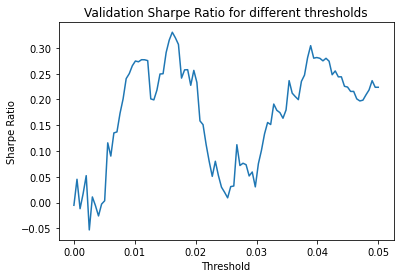

In [32]:
plt.plot(threshes,vals)
plt.xlabel("Threshold")
plt.ylabel("Sharpe Ratio")
a = plt.title("Validation Sharpe Ratio for different thresholds")

In [33]:
# Performance of the best validation threshold on test sample
opti_thresh = threshes[vals.index(max(vals))]
S_thresholding = BackTestStrat(thresholding,back_test,opti_thresh)
S_thresholding.run_backtest()
S_thresholding.report()

Portfolio Avg 6wk Return:     0.06332618251572115
Trade Avg 6wk Return:         0.04813754541408029
Portfolio Sharpe Ratio:       0.29102043696384683
# of Trades:                  1874


In [34]:
# Quantile strategy selling the lowest q % and buying the highest q% predicted each week
def weekly_quantiles(x,args):
    if x.__lagged_pred_mu_0 > x.loc[1-args[1]]:
        return 1
    elif x.__lagged_pred_mu_0 < x.loc[args[1]]:
        return -1
    else:
        return 0
def calc_quantiles(self):
    self.q = self.args[1]
    quants = pd.concat([self.bt_df.groupby(self.bt_df.index).__lagged_pred_mu_0.quantile(self.q),self.bt_df.groupby(self.bt_df.index).__lagged_pred_mu_0.quantile(1-self.q)],1)
    quants.columns = [self.q,1-self.q]
    self.bt_df = pd.concat([self.bt_df,quants],1)

q = 0.05
S_wk_quantiles = BackTestStrat(weekly_quantiles,back_test,[calc_quantiles,q])
S_wk_quantiles.args[0](S_wk_quantiles)
S_wk_quantiles.run_backtest()
S_wk_quantiles.report()

Portfolio Avg 6wk Return:     0.0563807181753412
Trade Avg 6wk Return:         0.005712583779880386
Portfolio Sharpe Ratio:       0.13504347620749474
# of Trades:                  454


In [35]:
# Optimising quantile on validation sample
q_vals = []
qs = np.linspace(0.001,0.49,50)
S_wk_quantiles = BackTestStrat(weekly_quantiles,back_val,[calc_quantiles,q])
for i in qs:
    S_wk_quantiles.args[1] = i
    S_wk_quantiles.args[0](S_wk_quantiles)
    q_vals.append(S_wk_quantiles.run_backtest())

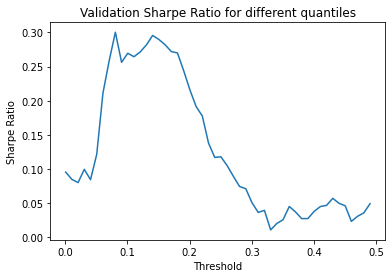

In [36]:
plt.plot(qs,q_vals)
plt.xlabel("Threshold")
plt.ylabel("Sharpe Ratio")
a = plt.title("Validation Sharpe Ratio for different quantiles")

In [37]:
# Performance of the best validation quantile on test sample
opti_q = qs[q_vals.index(max(q_vals))]
S_wk_quantiles = BackTestStrat(weekly_quantiles,back_test,[calc_quantiles,opti_q])
S_wk_quantiles.args[0](S_wk_quantiles)
S_wk_quantiles.run_backtest()
S_wk_quantiles.report()

Portfolio Avg 6wk Return:     0.1287513877795419
Trade Avg 6wk Return:         0.008157801429557753
Portfolio Sharpe Ratio:       0.23266703595873883
# of Trades:                  726


In [46]:
# Quantile Strategy with variable trade size based on quantile bin
def quantiles(x,args):
    return np.sign(x["quantiles"])*abs(x["quantiles"])**1

def generate_dist(num):
    num0=num%2
    numnon=num//2
    return list(range(-1*numnon,0)) + [0]*num0 + list(range(1,numnon+1))

def append_quantiles(self,num):
    self.bt_df.loc[:,"quantiles"] = pd.qcut(self.bt_df.__lagged_pred_mu_0,num,labels=generate_dist(num)).fillna(1).astype(int)
    
S_quantiles = BackTestStrat(quantiles,back_test,[append_quantiles])
S_quantiles.args[0](S_quantiles,10)
S_quantiles.run_backtest()
S_quantiles.report()

Portfolio Avg 6wk Return:     0.043600299347254595
Trade Avg 6wk Return:         0.05204560935246177
Portfolio Sharpe Ratio:       0.31540467878414735
# of Trades:                  13060


In [47]:
# Optimising number of bins on validation sample
n_vals=[]
nums=range(3,10,1)
for i in nums:
    S_quantiles = BackTestStrat(quantiles,back_val,[append_quantiles])
    S_quantiles.args[0](S_quantiles,i)
    n_vals.append(S_quantiles.run_backtest())

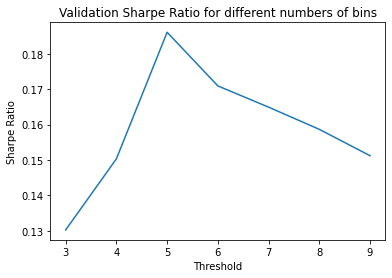

In [48]:
plt.plot(nums,n_vals)
plt.xlabel("Threshold")
plt.ylabel("Sharpe Ratio")
a = plt.title("Validation Sharpe Ratio for different numbers of bins")

In [49]:
# Performance of the best validation number of bins on test sample
opti_num = nums[n_vals.index(max(n_vals))]
S_quantiles = BackTestStrat(quantiles,back_test,[append_quantiles])
S_quantiles.args[0](S_quantiles,opti_num)
S_quantiles.run_backtest()
S_quantiles.report()

Portfolio Avg 6wk Return:     0.041843199413830086
Trade Avg 6wk Return:         0.05439968285561783
Portfolio Sharpe Ratio:       0.2955641769420658
# of Trades:                  5224


In [50]:
# Strategy weighting trade allocation by individual predicted Sharpe ratios, not full portfolio optimisation
def sharpe_func(x,args):
    try:
        if abs(x.__lagged_pred_mu_0/x.__lagged_pred_sigma_0)>args[0]:
            return x.__lagged_pred_mu_0/x.__lagged_pred_sigma_0
    except:
        return 0
   
S_sharpe = BackTestStrat(sharpe_func,back_test,[0.5])
S_sharpe.run_backtest()
S_sharpe.report()

Portfolio Avg 6wk Return:     0.0005342487907511942
Trade Avg 6wk Return:         0.0024138797253310217
Portfolio Sharpe Ratio:       0.024923357723700208
# of Trades:                  10.145204217363736


In [70]:
# Optimising sharpe threshold on validation sample
s_vals = []
s_threshes = np.linspace(0,0.4,100)
S_sharpe = BackTestStrat(sharpe_func,back_val,0.5)
for i in s_threshes:
    S_sharpe.args = [i]
    s_vals.append(S_sharpe.run_backtest())

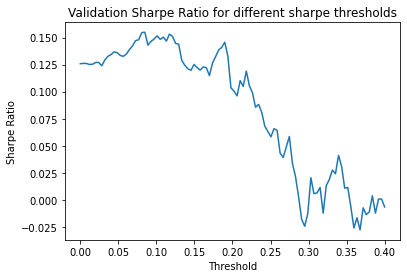

In [71]:
plt.plot(s_threshes,s_vals)
plt.xlabel("Threshold")
plt.ylabel("Sharpe Ratio")
a = plt.title("Validation Sharpe Ratio for different sharpe thresholds")

In [72]:
# Performance of the best validation number of bins on test sample
opti_s = s_threshes[s_vals.index(max(s_vals))]
S_sharpe = BackTestStrat(sharpe_func,back_test,[opti_s])
S_sharpe.run_backtest()
S_sharpe.report()

Portfolio Avg 6wk Return:     0.03563900150951608
Trade Avg 6wk Return:         0.0400713521862599
Portfolio Sharpe Ratio:       0.3514809706008464
# of Trades:                  541.4642306597124


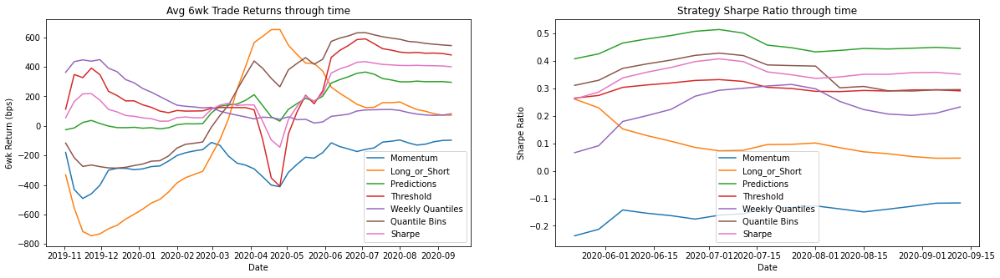

In [73]:
# Plot of how different strategies PnLs varied through time
Strategies={"Momentum":S_mean_revert,"Long_or_Short":S_long,"Predictions":S_predict,"Threshold":S_thresholding,
            "Weekly Quantiles":S_wk_quantiles,"Quantile Bins":S_quantiles,"Sharpe":S_sharpe}
fig,ax=plt.subplots(1,2,figsize=(20,5))
for i in Strategies.keys():
    weekly_pnls=Strategies[i].pnls.groupby(Strategies[i].pnls.index)
    weekly_decisions=Strategies[i].decisions.abs().groupby(Strategies[i].decisions.index)
    ax[0].plot(10000*np.cumsum(weekly_pnls.sum())
             / np.cumsum(weekly_decisions.sum().apply(lambda x: max(x,1))),label=i)
    ax[1].plot(Strategies[i].weekly_returns.expanding(30).mean()
               / Strategies[i].weekly_returns.expanding(30).std(),label=i)
ax[0].set_xlabel("Date")
ax[0].set_ylabel("6wk Return (bps)")
ax[0].set_title("Avg 6wk Trade Returns through time")
ax[1].set_xlabel("Date")
ax[1].set_ylabel("Sharpe Ratio")
ax[1].set_title("Strategy Sharpe Ratio through time")
ax[1].legend()
a = ax[0].legend()

### Using predictions for a factor report
We can use our test predictions as a factor for a quantile trading analysis using alphalens

In [74]:
my_factor=back_test[["__panel","__lagged_pred_mu_0"]]
my_factor.columns=["asset","factor"]
my_factor=my_factor.set_index([my_factor.index,my_factor.asset]).factor

In [75]:
returns=back_test[["__panel","__lagged_pred_mu_0"]]
returns.columns=["asset","42D"]
returns=returns.set_index([returns.index,returns.asset])["42D"]
returns.index.names=['date','asset']
my_factor.index.names=['date','asset']

In [76]:
factor_quantile = pd.qcut(my_factor,5,labels=range(1,6))
factor_quantile = factor_quantile.rename("factor_quantile")

In [77]:
factor_data = pd.concat([returns,my_factor,factor_quantile],1)

Returns Analysis


,42D
Ann. alpha,0.096
beta,0.113
Mean Period Wise Return Top Quantile (bps),280.618
Mean Period Wise Return Bottom Quantile (bps),-171.329
Mean Period Wise Spread (bps),619.261


/Users/tadhgokeeffe/env/lib/python3.8/site-packages/alphalens/tears.py:273: UserWarning: 'freq' not set in factor_data index: assuming business day
  warnings.warn(


<Figure size 432x288 with 0 Axes>

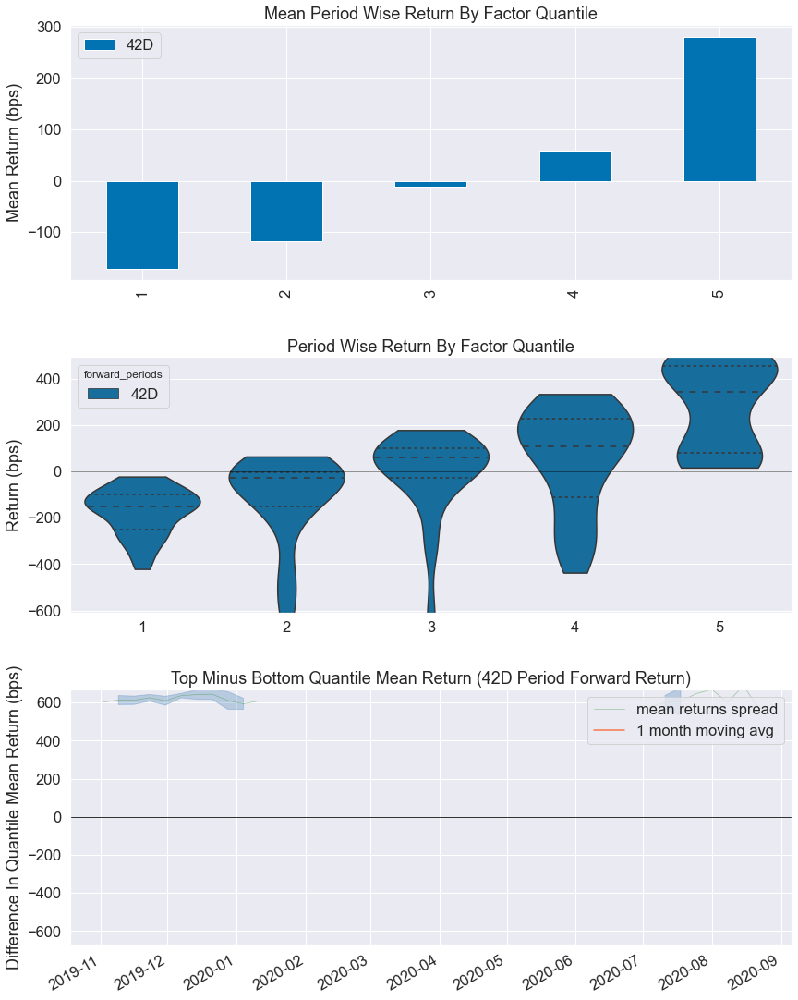

In [78]:
#factor_data = alphalens.utils.get_clean_factor(my_factor,returns)

# Run analysis
alphalens.tears.create_returns_tear_sheet(factor_data)